In [1]:
from pathlib import Path

import matplotlib.pyplot as plt
import numpy as np

import torch
import torch.nn as nn
import torchvision as vision
from torchsummary import summary

In [2]:
max_bands = 120
band_slice = slice(0, 115)
num_bands = len(range(*band_slice.indices(max_bands)))
print(num_bands)

115


In [13]:
class Autoencoder(nn.Module):
    def __init__(self):
        super().__init__()

        self.encoder = nn.Sequential(
            nn.Conv2d(num_bands, 32, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.BatchNorm2d(32),
            # nn.MaxPool2d(2, 2),
            
            nn.Conv2d(32, 16, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.BatchNorm2d(16),
            # nn.MaxPool2d(2, 2),
            
            # nn.Flatten(),
            # nn.Dropout(0.2, inplace=True),
            # nn.Linear(64 * 64 * 32, 1024),
        )

        self.decoder = nn.Sequential(
            # nn.Upsample(scale_factor=2),
            nn.Conv2d(16, 32, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.BatchNorm2d(32),
            
            # nn.Upsample(scale_factor=2),
            nn.Conv2d(32, num_bands, kernel_size=3, padding=1),
            nn.Sigmoid(),
        )

    def forward(self, x):
        x = self.encoder(x)
        x = self.decoder(x)

        return x

autoencoder = Autoencoder()
print(autoencoder)
summary(autoencoder, (num_bands, 64, 64), batch_size=512, device="cpu")

Autoencoder(
  (encoder): Sequential(
    (0): Conv2d(115, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (3): Conv2d(32, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (4): ReLU(inplace=True)
    (5): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (decoder): Sequential(
    (0): Conv2d(16, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (3): Conv2d(32, 115, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (4): Sigmoid()
  )
)
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1          [512, 32, 64, 64]          33,152
              ReLU-2          [512, 32, 64, 64]               

torch.Size([1, 115, 64, 64])
torch.Size([1, 115, 64, 64])


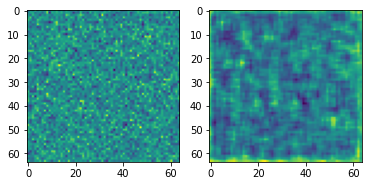

In [162]:
x_random = torch.randn(1, num_bands, 64, 64)
print(x_random.shape)

x_hat = autoencoder(x_random).detach()
print(x_hat.shape)

fig, (ax1, ax2) = plt.subplots(1, 2)
ax1.imshow(x_random[0, 0]);
ax2.imshow(x_hat[0, 0]);

In [4]:
data_dir = Path("../output/patches/64")
assert data_dir.exists(), "Invalid data directory"

def loader(file_path):
    hsi = np.load(file_path)
    hsi = hsi[..., band_slice]
    hsi = np.transpose(hsi, axes=[2, 0, 1])
    return hsi

torch.manual_seed(42)
np.random.seed(42)

dataset = vision.datasets.DatasetFolder(str(data_dir), loader, extensions=".npy")
dataloader = torch.utils.data.DataLoader(dataset, batch_size=64, shuffle=True)

_, (test_image, _) = next(enumerate(dataloader))
assert test_image.shape[1] == num_bands

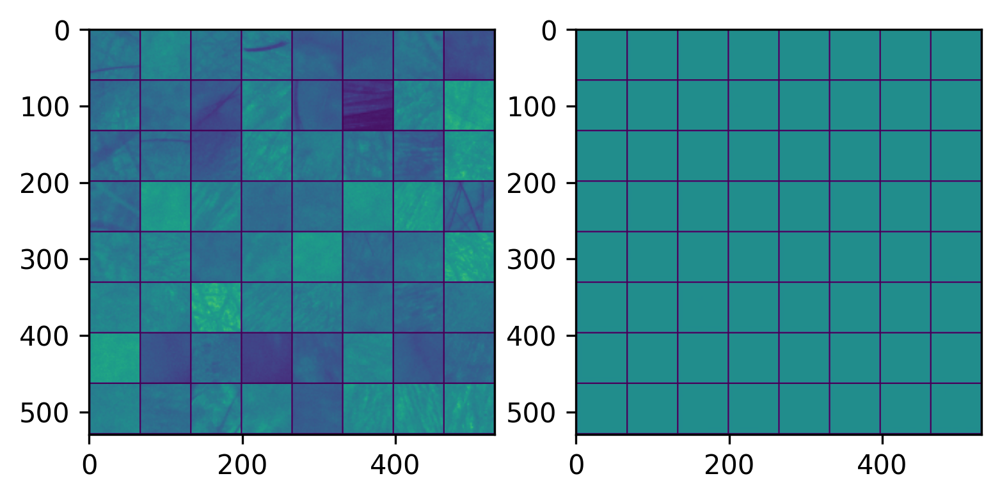

In [6]:
temp_image = autoencoder(test_image)
grid_orig = vision.utils.make_grid(torch.unsqueeze(test_image[:, 50].detach(), 1))
grid_reco = vision.utils.make_grid(torch.unsqueeze(temp_image[:, 50].detach(), 1))
fig, (ax1, ax2) = plt.subplots(1, 2, dpi=300)
ax1.imshow(np.transpose(grid_orig, axes=[1, 2, 0])[..., 0], vmin=0, vmax=1);
ax2.imshow(np.transpose(grid_reco, axes=[1, 2, 0])[..., 0], vmin=0, vmax=1);

epoch: 1
==> batch: 1
==> batch: 2
==> batch: 3
==> batch: 4
==> batch: 5
==> batch: 6
==> batch: 7
==> batch: 8
==> batch: 9
==> batch: 10
==> batch: 11
==> batch: 12
==> batch: 13
==> batch: 14
==> batch: 15
==> batch: 16
==> batch: 17
==> batch: 18
==> batch: 19
==> batch: 20
==> batch: 21
==> batch: 22
==> batch: 23
==> batch: 24
==> batch: 25
==> batch: 26
==> batch: 27
==> batch: 28
==> batch: 29
==> batch: 30
==> batch: 31
==> batch: 32
==> batch: 33
==> batch: 34
==> batch: 35
==> batch: 36
==> batch: 37
==> batch: 38
==> batch: 39
==> batch: 40
==> batch: 41
==> batch: 42
==> batch: 43
==> batch: 44
==> batch: 45
==> batch: 46
==> batch: 47
==> batch: 48
==> batch: 49
==> batch: 50
==> batch: 51
==> batch: 52
==> batch: 53
==> batch: 54
==> batch: 55
==> batch: 56
==> batch: 57
==> batch: 58
==> batch: 59
==> batch: 60
==> batch: 61
==> batch: 62
==> batch: 63
==> batch: 64
==> batch: 65
==> batch: 66
==> batch: 67
==> batch: 68
==> batch: 69
==> batch: 70
==> batch: 71
==> ba

<ipython-input-180-0283bb9372e0>:29: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, (ax1, ax2) = plt.subplots(1, 2, dpi=300)


epoch: 22
==> batch: 1
==> batch: 2
==> batch: 3
==> batch: 4
==> batch: 5
==> batch: 6
==> batch: 7
==> batch: 8
==> batch: 9
==> batch: 10
==> batch: 11
==> batch: 12
==> batch: 13
==> batch: 14
==> batch: 15
==> batch: 16
==> batch: 17
==> batch: 18
==> batch: 19
==> batch: 20
==> batch: 21
==> batch: 22
==> batch: 23
==> batch: 24
==> batch: 25
==> batch: 26
==> batch: 27
==> batch: 28
==> batch: 29
==> batch: 30
==> batch: 31
==> batch: 32
==> batch: 33
==> batch: 34
==> batch: 35
==> batch: 36
==> batch: 37
==> batch: 38
==> batch: 39
==> batch: 40
==> batch: 41
==> batch: 42
==> batch: 43
==> batch: 44
==> batch: 45
==> batch: 46
==> batch: 47
==> batch: 48
==> batch: 49
==> batch: 50
==> batch: 51
==> batch: 52
==> batch: 53
==> batch: 54
==> batch: 55
==> batch: 56
==> batch: 57
==> batch: 58
==> batch: 59
==> batch: 60
==> batch: 61
==> batch: 62
==> batch: 63
==> batch: 64
==> batch: 65
==> batch: 66
==> batch: 67
==> batch: 68
==> batch: 69
==> batch: 70
==> batch: 71
==> b

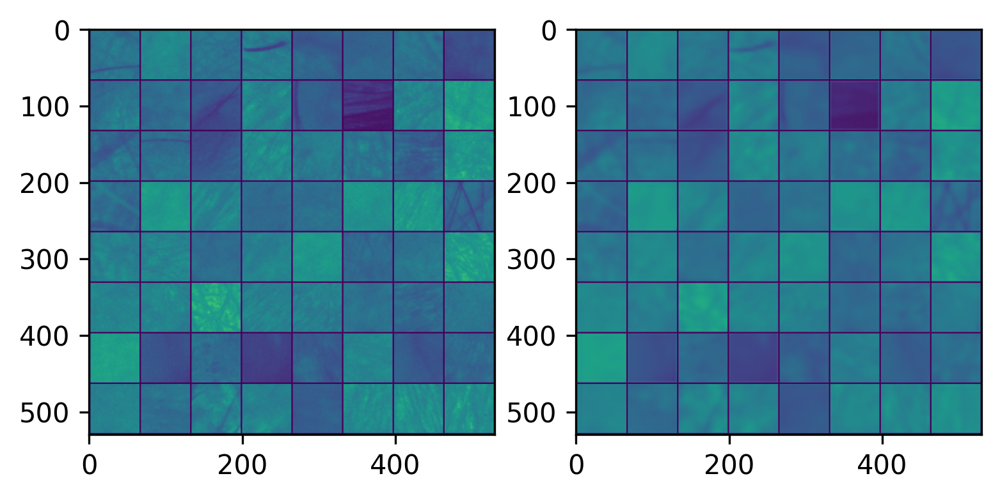

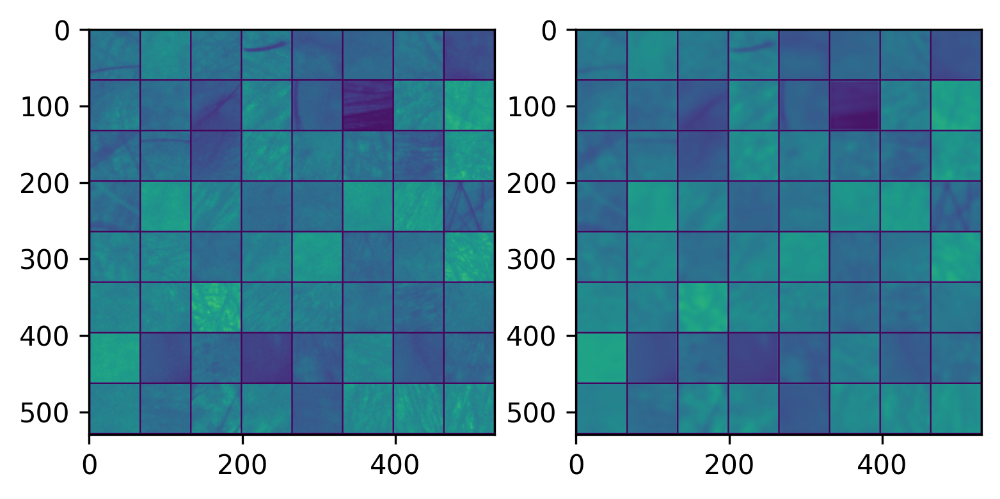

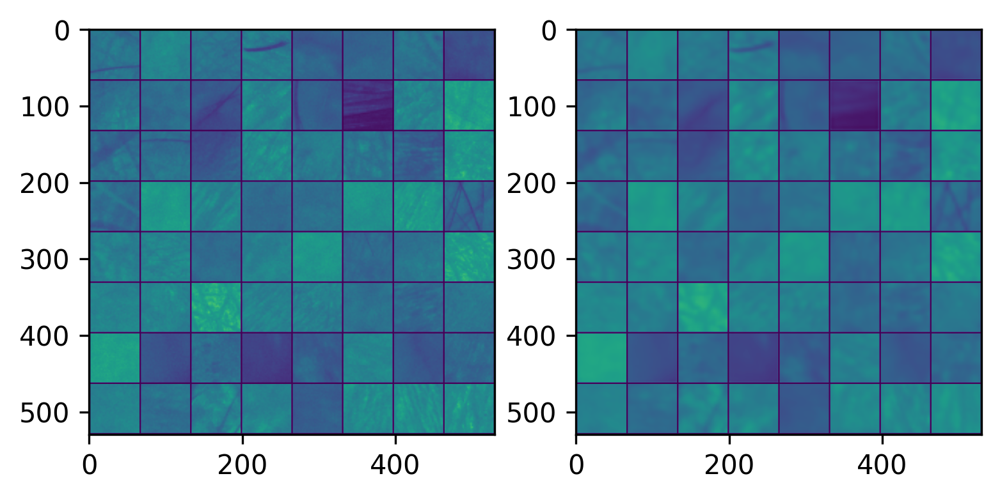

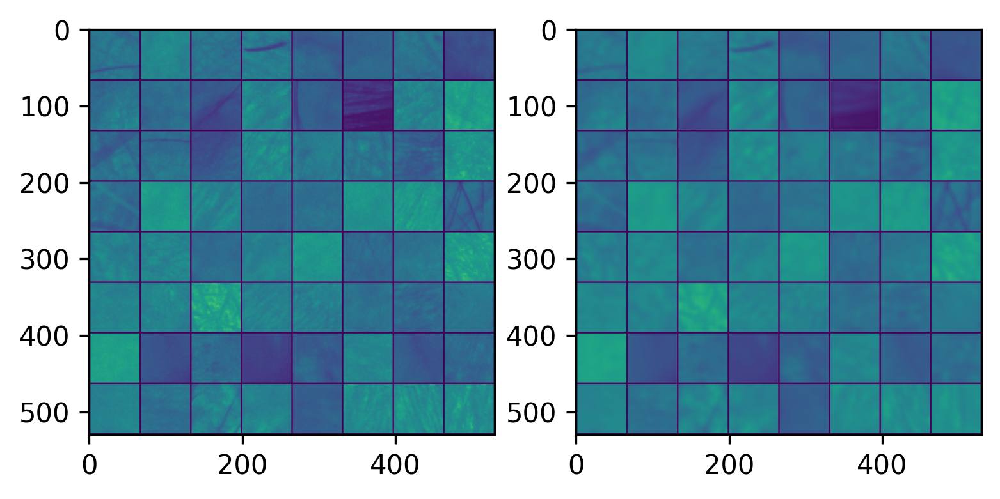

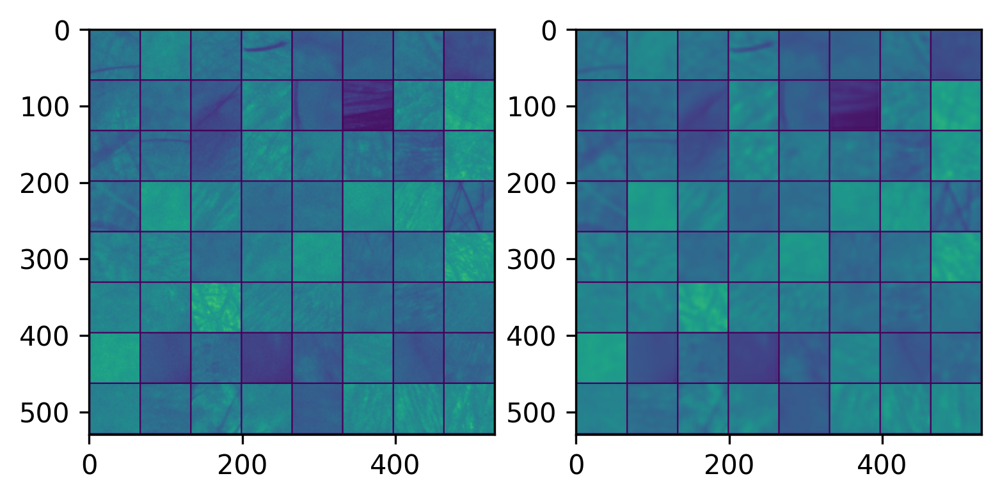

...

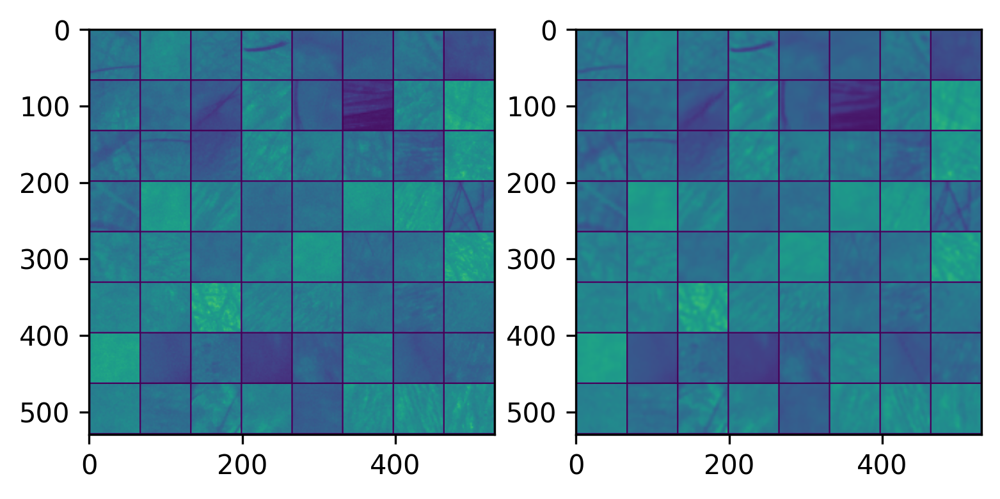

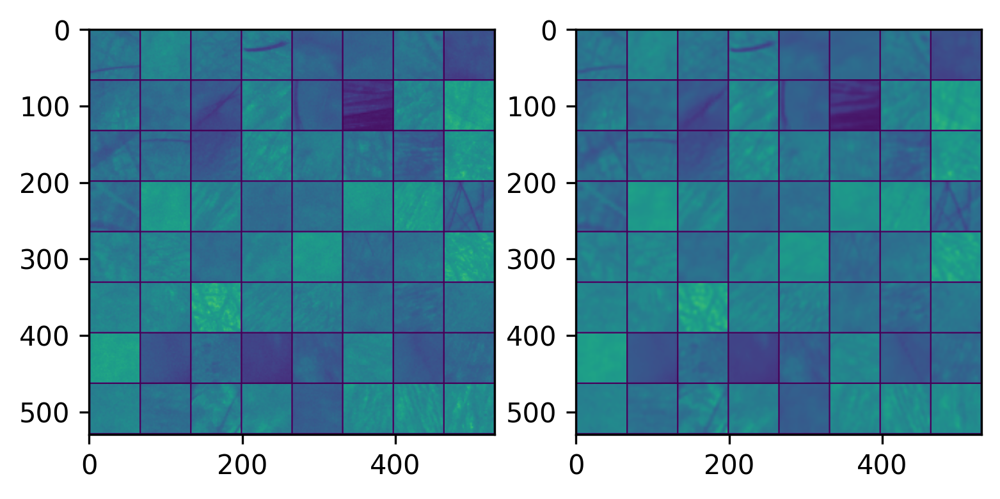

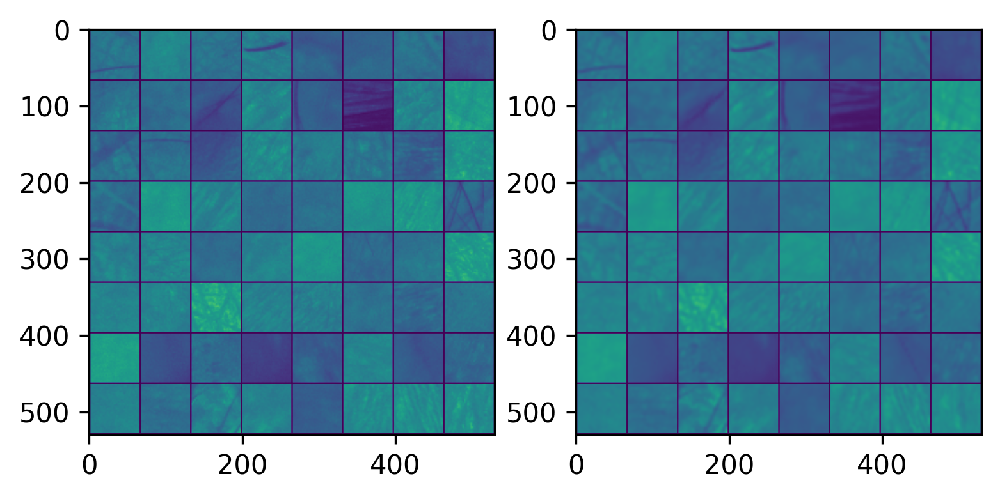

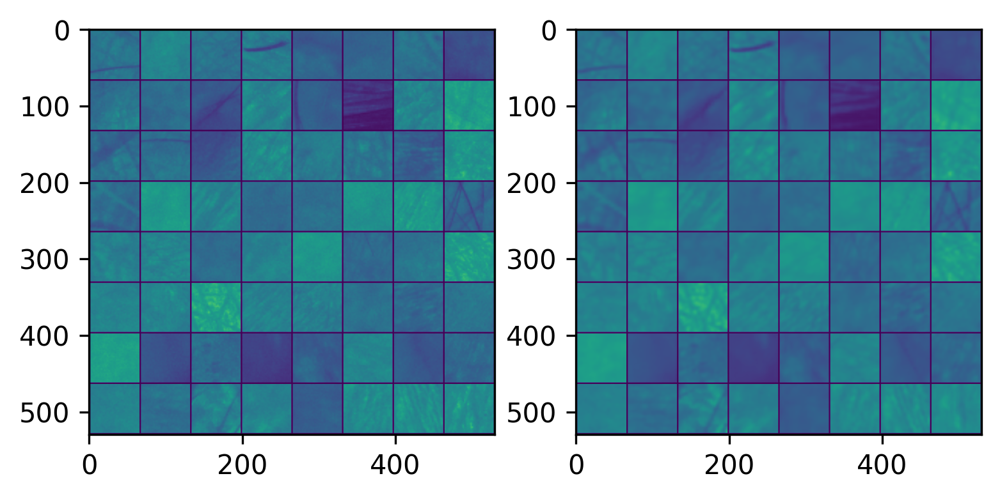

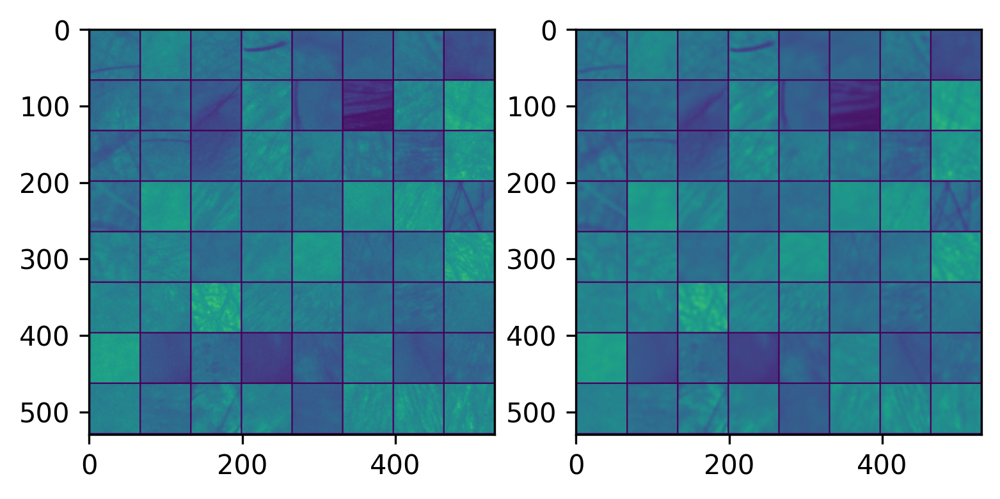

In [180]:
autoencoder = Autoencoder()

# criterion = nn.MSELoss()
criterion = nn.BCELoss()
optimizer = torch.optim.Adam(autoencoder.parameters())

autoencoder.train()
for epoch in range(0, 50):
    print("epoch:", epoch + 1)
    train_loss = 0
    for batch_idx, (image, _) in enumerate(dataloader):
#         if batch_idx == 4:
#             break
        print("==> batch:", batch_idx + 1)
        optimizer.zero_grad()
        reconstructed_image = autoencoder(image)
        loss = criterion(reconstructed_image, image)
        loss.backward()
        optimizer.step()        
        train_loss += loss.item()

    print(train_loss / len(dataloader.dataset))
    
    with torch.no_grad():
        image = test_image
        reconstructed_image = autoencoder(image)
        grid_orig = vision.utils.make_grid(torch.unsqueeze(image[:, 50].detach(), 1))
        grid_reco = vision.utils.make_grid(torch.unsqueeze(reconstructed_image[:, 50].detach(), 1))
        fig, (ax1, ax2) = plt.subplots(1, 2, dpi=300)
        ax1.imshow(np.transpose(grid_orig, axes=[1, 2, 0])[..., 0], vmin=0, vmax=1)
        ax2.imshow(np.transpose(grid_reco, axes=[1, 2, 0])[..., 0], vmin=0, vmax=1)
#     break